In [1]:
from torchvision import transforms, models 
import torch

import warnings
warnings.filterwarnings(action='ignore')
import numpy as np

from data.camMethods import imageMapping
from data.camMethods import preprocessingImage
from data.camMethods import visualizationCAM
from data.camMethods import camMethod
from data.camMethods import camForSet
from data.camMethods import camsForLayersRes50

from data.Hook import actLayerMethod
from data.Hook import weightFromLayer

In [2]:
model = models.resnet50()
model.load_state_dict(torch.load('model_parameters/resnet50-0676ba61.pth'))
model.eval()
print()

In [3]:
# PATH_TO_SET = 'dataset/catset'
PATH_TO_SET = 'dataset/mergeDataset'


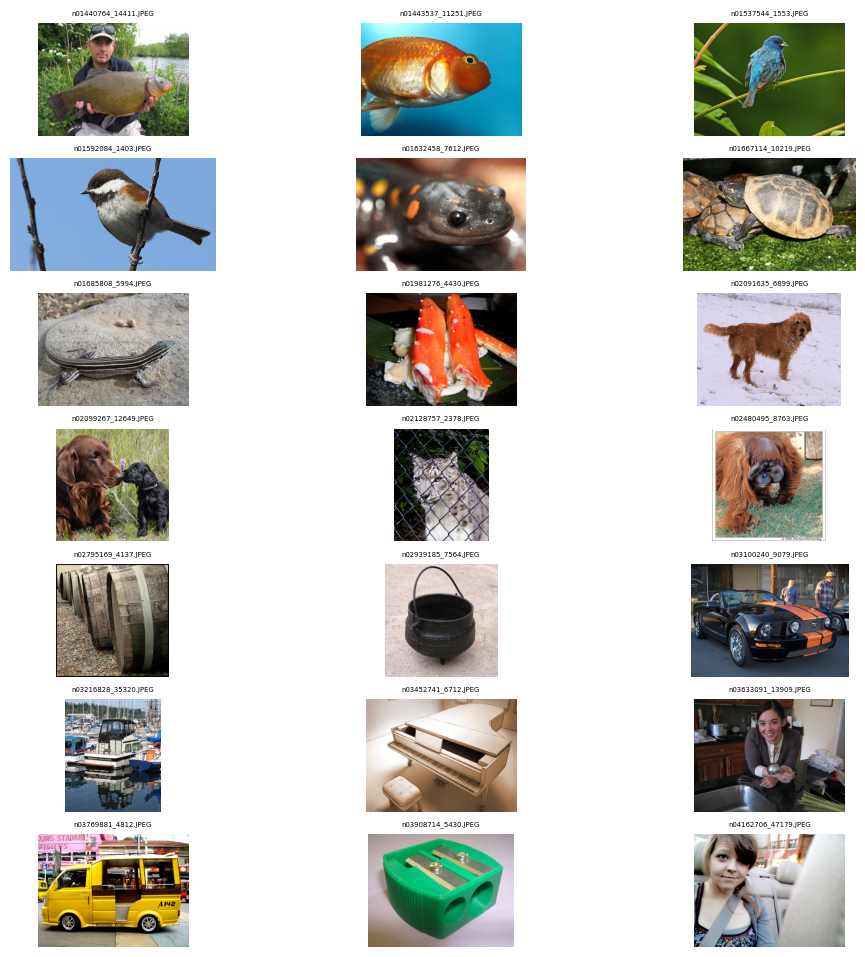

In [4]:
listImage = imageMapping(PATH_TO_SET)  

In [5]:
preprocessingList = preprocessingImage(listImage)
print(len(preprocessingList), '\n', preprocessingList[0].shape)

21 
 torch.Size([1, 3, 224, 224])


In [6]:
weight_layer_1 = model._modules.get('layer1').get_submodule('2')\
                                                .get_submodule('bn3')
weight_layer_2 = model._modules.get('layer2').get_submodule('3')\
                                                .get_submodule('bn3')
weight_layer_3 = model._modules.get('layer3').get_submodule('5')\
                                        .get_submodule('bn3')
weight_layer_4 = model._modules.get('layer4').get_submodule('2')\
                                        .get_submodule('bn3')
weight_layer_fc = model._modules.get('fc')

listOfWeight = np.array([weight_layer_1, weight_layer_2, weight_layer_3,
                         weight_layer_4, weight_layer_fc], dtype=object)

In [7]:
listOfCams = camsForLayersRes50(model, preprocessingList, listOfWeight)

In [8]:
[visualizationCAM(PATH_TO_SET, cam) for cam in listOfCams]

[None, None, None, None, None]